In [1]:
from google.colab import drive
drive.mount('/content/drive')

import os

# Define the path to your zip file
zip_path = '/content/drive/My Drive/Datasets/dataset_maps.zip'

# Define the extraction path
extract_to = '/content/maps'

# Create the extraction directory if it doesn't exist
os.makedirs(extract_to, exist_ok=True)

os.makedirs('results', exist_ok=True)

# Unzip the file
!unzip -q "$zip_path" -d "$extract_to"

Mounted at /content/drive


In [2]:
import numpy as np
import pandas as pd
import os

In [3]:
import torch
torch.set_float32_matmul_precision('medium')  # or 'high'
import torch.nn as nn
import torchvision.transforms as T
import torchvision.transforms.functional as TF

class MapsTransform:
    def __init__(self, mirror_prob: float = 0):
        self.mirror_prob = mirror_prob

    def __jitter(self, x, y):
        torch.manual_seed(42)
        random_crop = T.RandomCrop((256, 256))
        x, y = random_crop(x), random_crop(y)
        torch.manual_seed(0)
        return x, y


    def __call__(self, x, y):

        # resizing
        x, y = TF.resize(x, [286, 286]), TF.resize(y, [286, 286])

        # random jittering
        x, y = self.__jitter(x, y)

        # horizontal flip
        r = np.random.uniform()
        if r <= self.mirror_prob:
            x, y = TF.hflip(x), TF.hflip(y)

        return {
            "areal": x,
            "map_pic": y
        }

In [4]:
from PIL import Image
from torch.utils.data import Dataset, DataLoader

class MapsDataset(Dataset):
    def __init__(self, img_folder: str, transform = None):
        self.img_folder = img_folder
        self.imgs = os.listdir(img_folder)
        self.transform = transform

    def __len__(self):
        return len(self.imgs)

    def __getitem__(self, idx):
        img_name = self.imgs[idx]
        img = os.path.join(self.img_folder, img_name)
        img = Image.open(img)
        img = TF.to_tensor(img)
        width = img.shape[2] // 2
        areal, map_pic = img[:, :, :width], img[:, :, width:]
        if self.transform != None:
            transformed = self.transform(areal, map_pic)
            areal, map_pic = transformed["areal"], transformed["map_pic"]
        areal = TF.normalize(areal, (0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
        map_pic = TF.normalize(map_pic, (0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
        return {
            "areal": areal,
            "map_pic": map_pic
        }

In [5]:
!pip install pytorch_lightning

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 812.2/812.2 kB 16.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 868.8/868.8 kB 49.4 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-man

In [6]:
import pytorch_lightning as pl

class DataModule(pl.LightningDataModule):
    def __init__(self, batch_size=1):
        super().__init__()
        self.batch_size=batch_size

    def setup(self, stage=None):
        transform = MapsTransform(0.5)
        self.train_dataset = MapsDataset("maps/train", transform)
        self.validation_dataset = MapsDataset("maps/val", transform)

    def train_dataloader(self):
        train_loader = DataLoader(
            self.train_dataset,
            batch_size=self.batch_size,
            shuffle=True
        )
        return train_loader

    def val_dataloader(self):
        val_loader = DataLoader(
            self.validation_dataset,
            batch_size=self.batch_size,
            shuffle=False
        )
        return val_loader

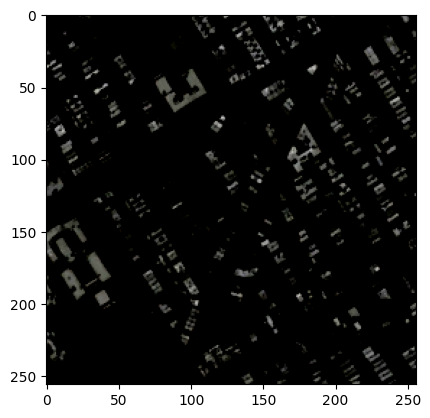

In [7]:
ds = MapsDataset("maps/train", MapsTransform(1))
a = ds[101]
areal, map_pic = a["areal"], a["map_pic"]
areal = areal.numpy()
areal = np.moveaxis(areal, 0, 2)
import matplotlib.pyplot as plt

plt.imshow(areal)


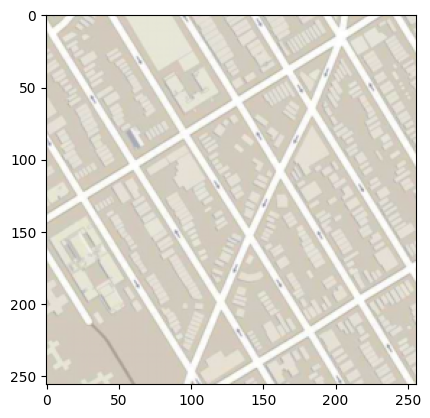

In [8]:
map_pic = map_pic.numpy()
map_pic = np.moveaxis(map_pic, 0, 2)
plt.imshow(map_pic)

In [9]:
np.min(map_pic)

0.56917214

In [10]:
class DownBlock(nn.Module):
    def __init__(
        self,
        num_channels: int,
        num_filters: int,
        use_norm: bool = True,
        last_layer: bool = False
    ):
        super().__init__()
        stride = 1 if last_layer else 2
        self.conv = nn.Conv2d(num_channels, num_filters, 4, stride, 1)
        self.norm = nn.InstanceNorm2d(num_filters, affine=True) if use_norm else nn.Identity()
        self.leaky = nn.LeakyReLU(0.2)

    def forward(self, x):
        x = self.conv(x)
        x = self.norm(x)
        return self.leaky(x)

class UpBlock(nn.Module):
    def __init__(
        self,
        num_channels: int,
        num_filters: int,
        use_dropout: bool = False
    ):
        super().__init__()
        self.conv = nn.ConvTranspose2d(num_channels, num_filters, 4, 2, 1)
        self.relu = nn.ReLU()
        self.norm = nn.InstanceNorm2d(num_filters, affine=True)
        self.drop = nn.Dropout(0.5) if use_dropout else nn.Identity()

    def forward(self, x):
        x = self.conv(x)
        x = self.norm(x)
        x = self.drop(x)
        return self.relu(x)




In [11]:
class Discriminator(nn.Module):
    def __init__(self, input_channels: int = 3):
        super().__init__()
        self.down1 = DownBlock(input_channels * 2, 64, use_norm=False)
        self.down2 = DownBlock(64, 128)
        self.down3 = DownBlock(128, 256)
        self.down4 = DownBlock(256, 512, last_layer=True)
        self.final = nn.Conv2d(512, 1, kernel_size=4, padding=1)

    def forward(self, x, y):
        x = torch.cat([x, y], dim=1)
        x = self.down1(x)
        x = self.down2(x)
        x = self.down3(x)
        x = self.down4(x)

        return self.final(x)


class Generator(nn.Module):
    def __init__(self, input_channels: int = 3):
        super().__init__()
        self.input_channels = input_channels
        self.down1 = DownBlock(input_channels, 64, use_norm=False)
        self.down2 = DownBlock(64, 128)
        self.down3 = DownBlock(128, 256)
        self.down4 = DownBlock(256, 512)
        self.down5 = DownBlock(512, 512)
        self.down6 = DownBlock(512, 512)
        self.down7 = DownBlock(512, 512)

        self.bottleneck = DownBlock(512, 512, last_layer=True, use_norm=False)

        self.up1 = UpBlock(512, 512, True)
        self.up2 = UpBlock(1024, 512, True)
        self.up3 = UpBlock(1024, 512, True)
        self.up4 = UpBlock(1024, 512)
        self.up5 = UpBlock(1024, 256)
        self.up6 = UpBlock(512, 128)
        self.up7 = UpBlock(256, 64)
        self.up8 = nn.ConvTranspose2d(128, input_channels, 4, 2, 1)
        self.tanh = nn.Tanh()

    def forward(self, x):
        d1 = self.down1(x)
        d2 = self.down2(d1)
        d3 = self.down3(d2)
        d4 = self.down4(d3)
        d5 = self.down5(d4)
        d6 = self.down6(d5)
        d7 = self.down7(d6)

        btn = self.bottleneck(d7)

        up1 = self.up1(btn)
        up2 = self.up2(torch.concat([up1, d7], dim=1))
        up3 = self.up3(torch.concat([up2, d6], dim=1))
        up4 = self.up4(torch.concat([up3, d5], dim=1))
        up5 = self.up5(torch.concat([up4, d4], dim=1))
        up6 = self.up6(torch.concat([up5, d3], dim=1))
        up7 = self.up7(torch.concat([up6, d2], dim=1))
        up8 = self.up8(torch.concat([up7, d1], dim=1))
        return self.tanh(up8)

In [12]:
def init_weights(m):
    if isinstance(m, DownBlock):
        nn.init.normal_(m.conv.weight, 0.0, 0.02)
        if isinstance(m.norm, nn.InstanceNorm2d):
            nn.init.normal_(m.norm.weight, 0.0, 0.02)

    elif isinstance(m, UpBlock):
        nn.init.normal_(m.conv.weight, 0.0, 0.02)
        nn.init.normal_(m.norm.weight, 0.0, 0.02)

    elif isinstance(m, nn.Conv2d):
        nn.init.normal_(m.weight, 0.0, 0.02)


def display_results(x, y, y_hat, current_epoch: int, path: str,figsize=(10,5)):
    x = x.detach().cpu().permute(1, 2, 0)
    y = y.detach().cpu().permute(1, 2, 0)
    y_hat = y_hat.detach().cpu().permute(1, 2, 0)

    x, y, y_hat = x.float(), y.float(), y_hat.float()

    images = [x, y, y_hat]
    titles = ['input','real','generated']
    print(f'Epoch: {current_epoch}')
    fig, ax = plt.subplots(1, 3, figsize=figsize)
    for idx,img in enumerate(images):
        ax[idx].imshow(img)
        ax[idx].axis("off")
    for idx, title in enumerate(titles):
        ax[idx].set_title('{}'.format(title))
    plt.savefig(path)
    plt.show()

In [13]:
m = Generator()
m.apply(init_weights)
a = m(torch.rand(1, 3, 256, 256))
a.shape

torch.Size([1, 3, 256, 256])

In [14]:
m = Discriminator()
m.apply(init_weights)
a = m(torch.rand(1, 3, 256, 256), torch.rand(1, 3, 256, 256))
a.shape

torch.Size([1, 1, 30, 30])

## Pix2Pix Loss Functions

In the provided `Pix2Pix` implementation, two loss functions are used: Binary Cross-Entropy with Logits Loss (`BCEWithLogitsLoss`) and L1 Loss (Mean Absolute Error).

### Discriminator Loss
The discriminator loss measures how well the discriminator is able to distinguish between real and fake images. It's computed using `BCEWithLogitsLoss` to compare the discriminator's predictions with the true labels (real images as 1 and fake images as 0).

- **Discriminator Real Loss**: This is the BCE loss between the discriminator's predictions on real images and a target of ones (indicating real).
- **Discriminator Fake Loss**: This is the BCE loss between the discriminator's predictions on fake images (generated by the generator) and a target of zeros (indicating fake).
- **Total Discriminator Loss**: The average of the real and fake losses.

### Generator Loss
The generator loss is a combination of two losses:

1. **Adversarial Loss**: This uses `BCEWithLogitsLoss` to measure how well the generator is able to fool the discriminator. The target for this loss is ones because the generator aims to make the discriminator believe that the fake images are real.
2. **L1 Loss**: This is the mean absolute error between the generated images and the real images, scaled by a factor of 200. This encourages the generated images to be similar to the real images in terms of pixel values.

The final generator loss is the sum of the adversarial loss and the scaled L1 loss.


In [29]:
class Pix2Pix(pl.LightningModule):
    def __init__(self):
        super().__init__()
        self.save_hyperparameters()
        self.discriminator = Discriminator(3)
        self.generator = Generator(3)
        self.generator.apply(init_weights)
        self.discriminator.apply(init_weights)
        self.bce = nn.BCEWithLogitsLoss()
        self.l1 = nn.L1Loss()

        # Set automatic optimization to False
        self.automatic_optimization = False

    def forward(self, x):
        return self.generator(x)

    def training_step(self, batch, batch_idx):
        x, y = batch["areal"], batch["map_pic"]

        # Get optimizers
        opt_d, opt_g = self.optimizers()

        # Train Discriminator
        opt_d.zero_grad()
        y_fake = self(x)
        D_real = self.discriminator(x, y)
        D_fake = self.discriminator(x, y_fake.detach())
        D_real_loss = self.bce(D_real, torch.ones_like(D_real))
        D_fake_loss = self.bce(D_fake, torch.zeros_like(D_fake))
        loss_d = (D_real_loss + D_fake_loss) / 2
        self.manual_backward(loss_d)
        opt_d.step()
        self.log('Discriminator loss', loss_d, prog_bar=True)

        # Train Generator
        opt_g.zero_grad()
        y_fake = self(x)
        D_fake = self.discriminator(x, y_fake)
        loss_g = self.bce(D_fake, torch.ones_like(D_fake))
        l1_loss = self.l1(y_fake, y) * 200
        loss_g += l1_loss
        self.manual_backward(loss_g)
        opt_g.step()
        self.log('Generator loss', loss_g, prog_bar=True)

        # Optionally save results periodically
        if batch_idx == 0:
            y_hat = self(x).detach()
            display_results(
                x[0],
                y[0],
                y_hat[0],
                self.current_epoch,
                "results/{}".format(self.current_epoch)
            )

    def configure_optimizers(self):
        generator_opt = torch.optim.Adam(self.generator.parameters(),  0.0002, betas=(0.5, 0.999))
        discriminator_opt = torch.optim.Adam(self.discriminator.parameters(),  0.0002, betas=(0.5, 0.999))
        return [discriminator_opt, generator_opt]


INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name          | Type              | Params | Mode 
------------------------------------------------------------
0 | discriminator | Discriminator     | 2.8 M  | train
1 | generator     | Generator         | 54.4 M | train
2 | bce           | BCEWithLogitsLoss | 0      | train
3 | l1            | L1Loss            | 0      | train
------------------------------------------------------------
57.2 M    Trainable params
0         Non-trainable params
57.2 M    Total params
228.756   Total estimated model params size (MB)


Training: |          | 0/? [00:00<?, ?it/s]

Epoch: 0


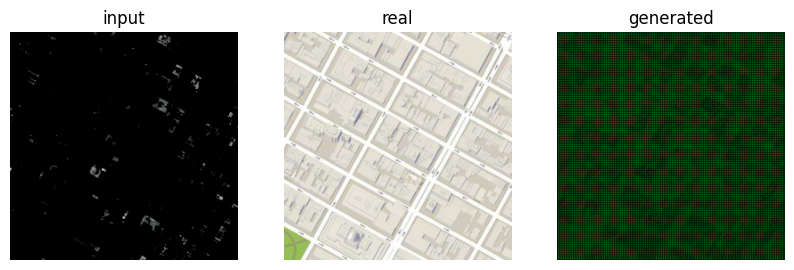

Epoch: 1


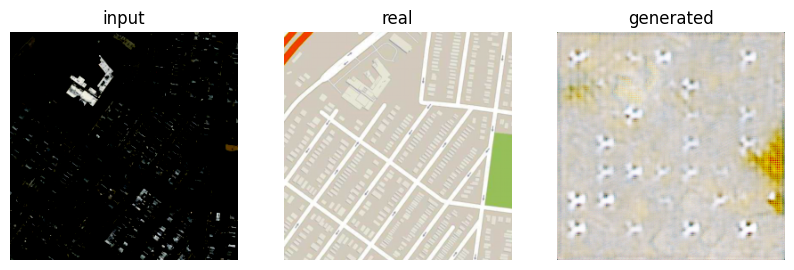

Epoch: 2


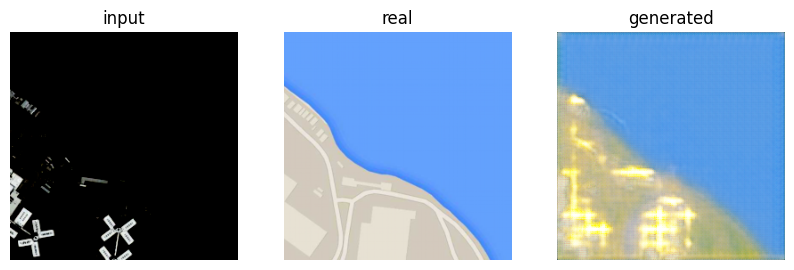

Epoch: 3


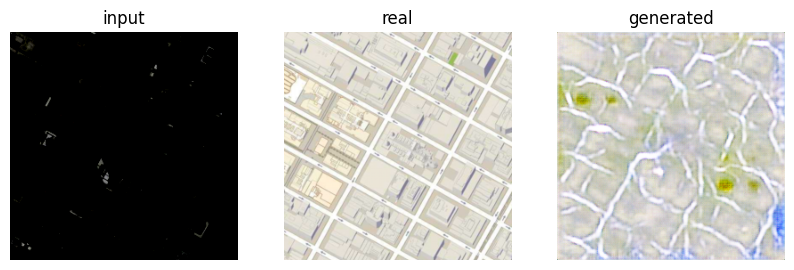

Epoch: 4


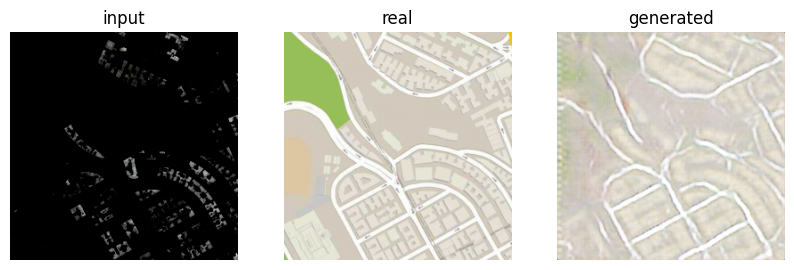

Epoch: 5


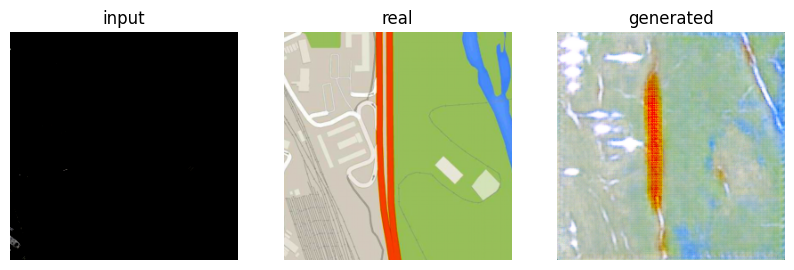

Epoch: 6


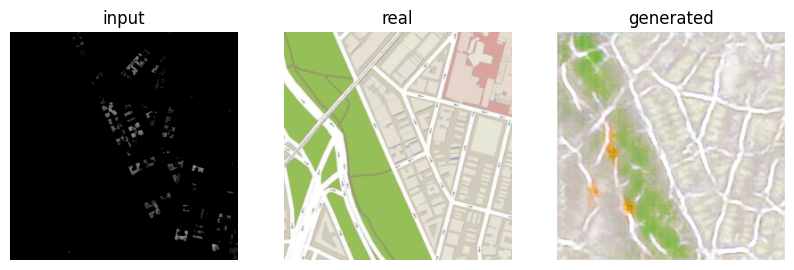

Epoch: 7


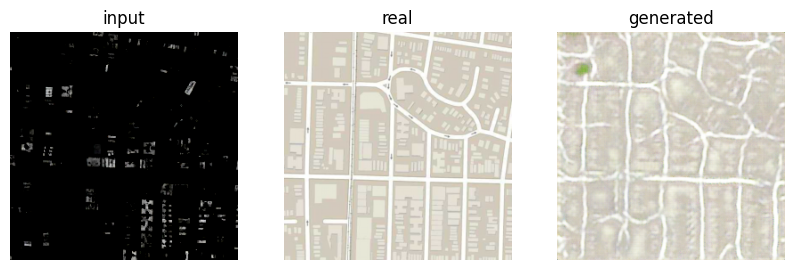

Epoch: 8


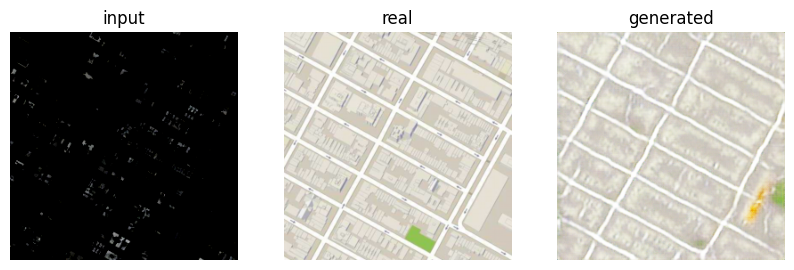

Epoch: 9


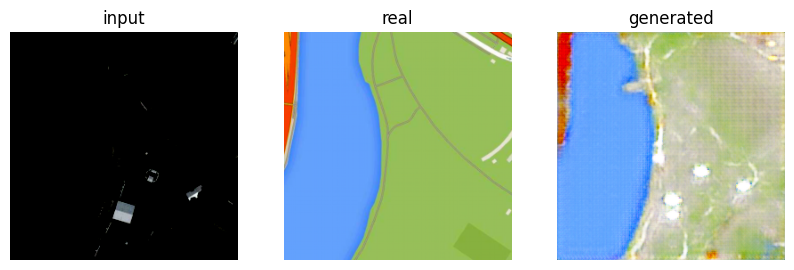

Epoch: 10


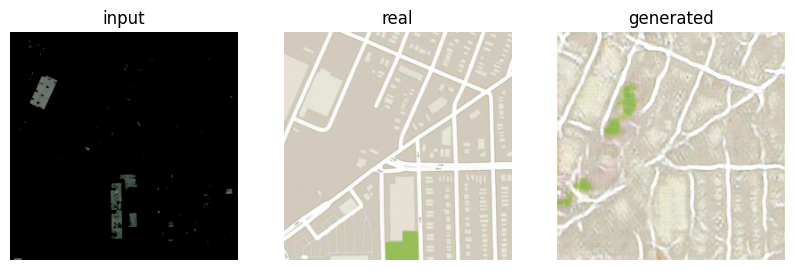

Epoch: 11


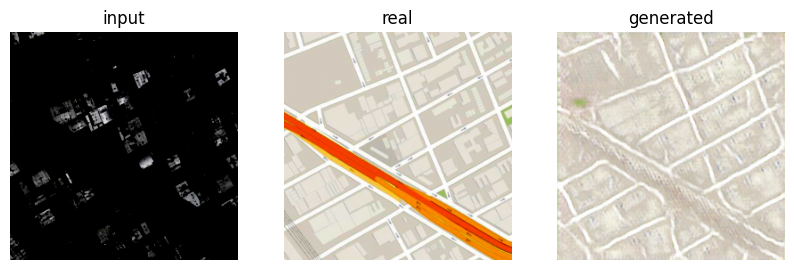

Epoch: 12


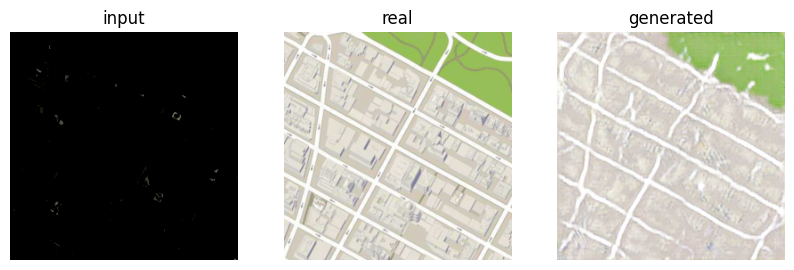

Epoch: 13


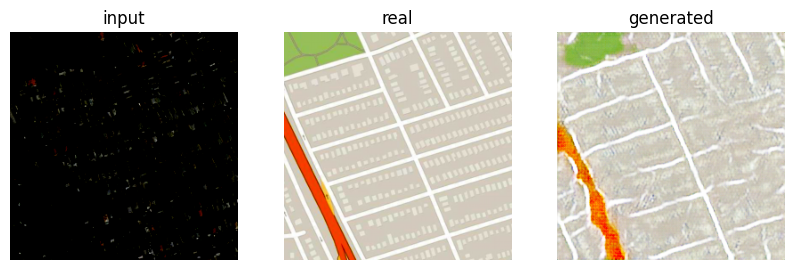

Epoch: 14


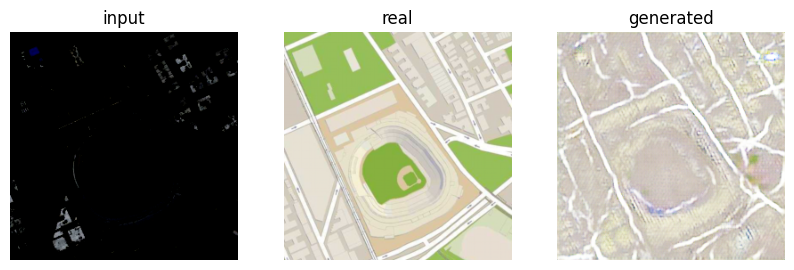

Epoch: 15


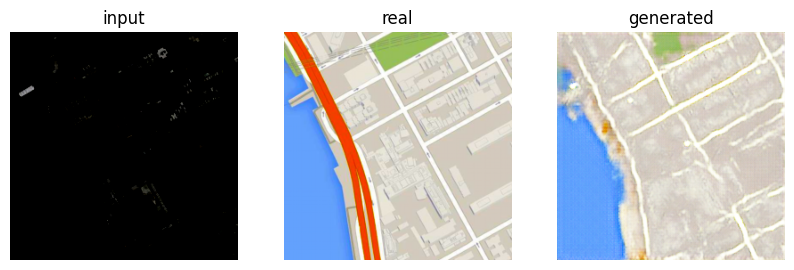

Epoch: 16


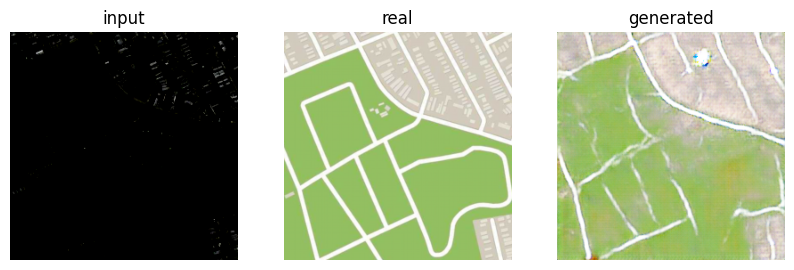

Epoch: 17


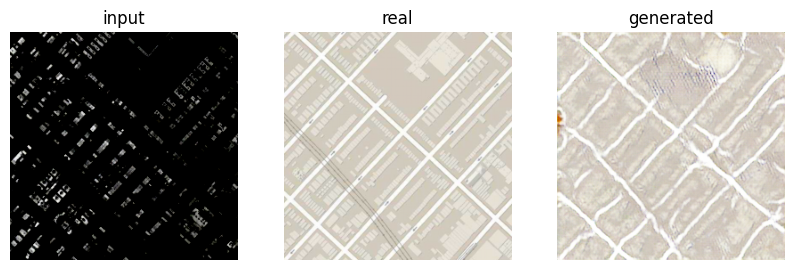

Epoch: 18


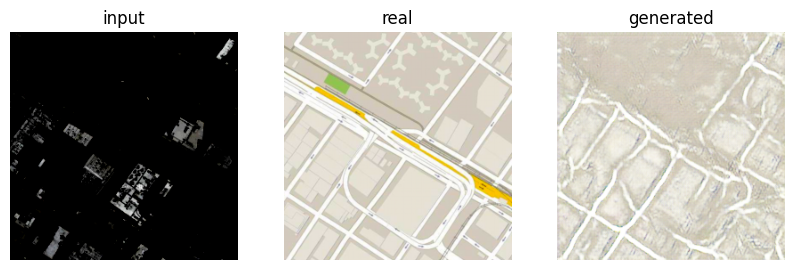

Epoch: 19


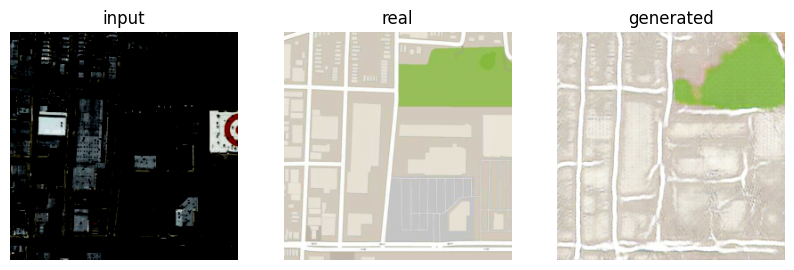

Epoch: 20


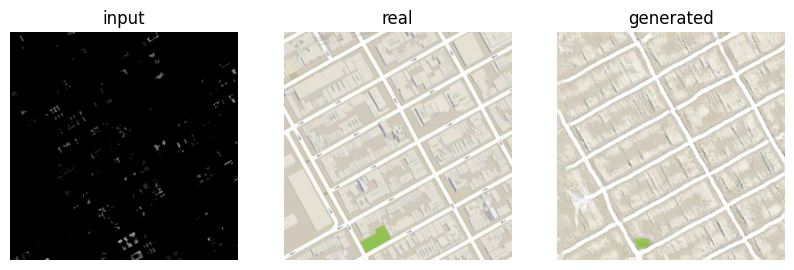

Epoch: 21


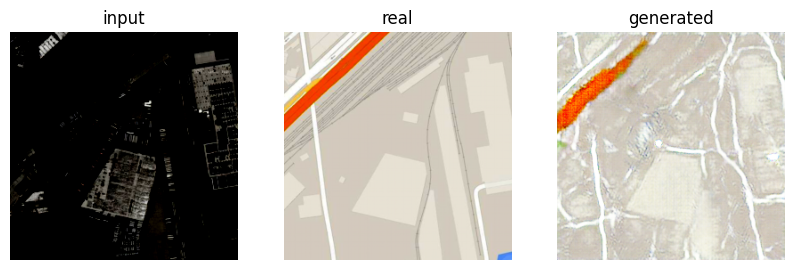

Epoch: 22


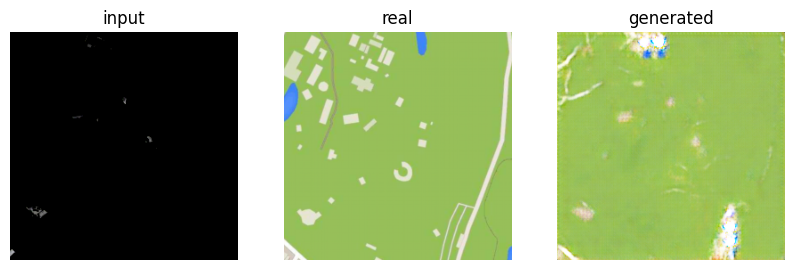

Epoch: 23


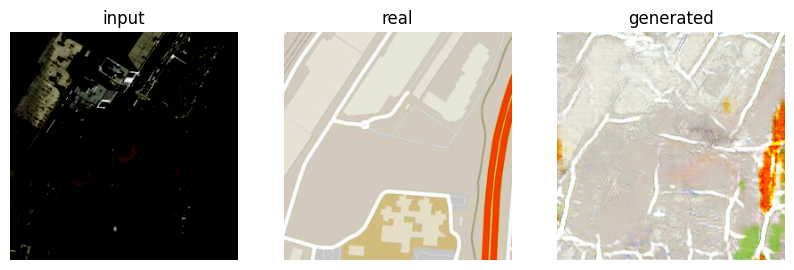

Epoch: 24


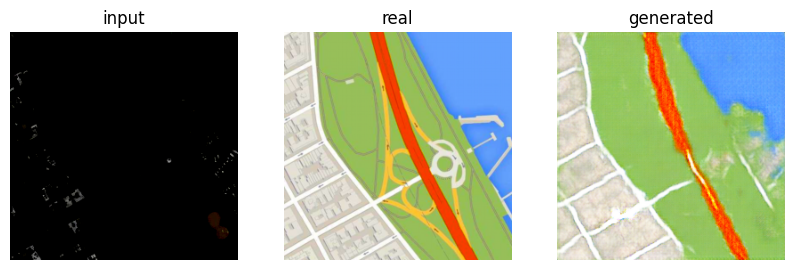

Epoch: 25


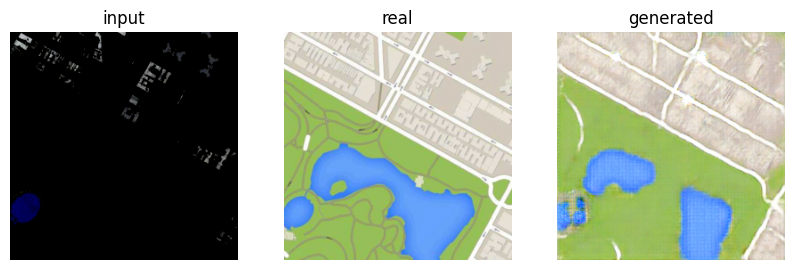

Epoch: 26


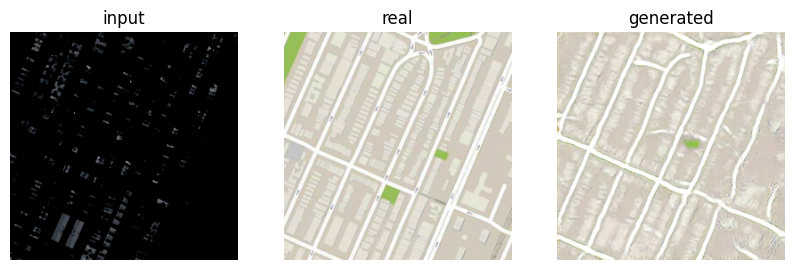

Epoch: 27


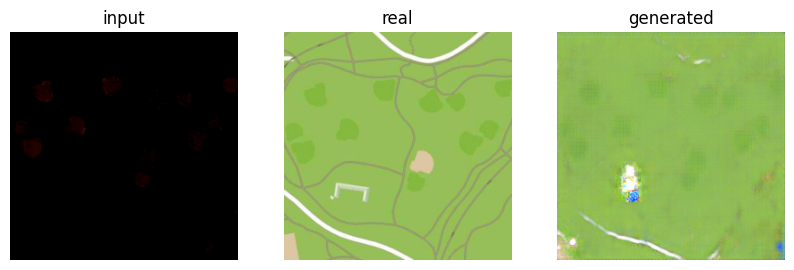

Epoch: 28


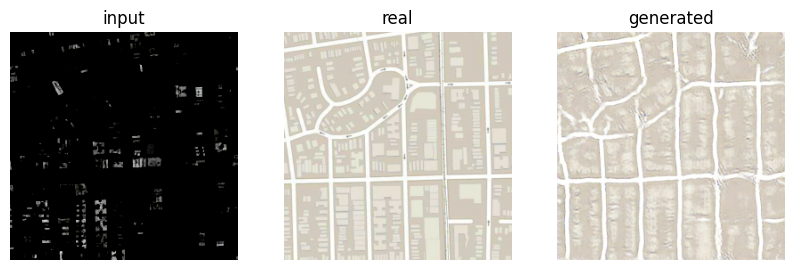

Epoch: 29


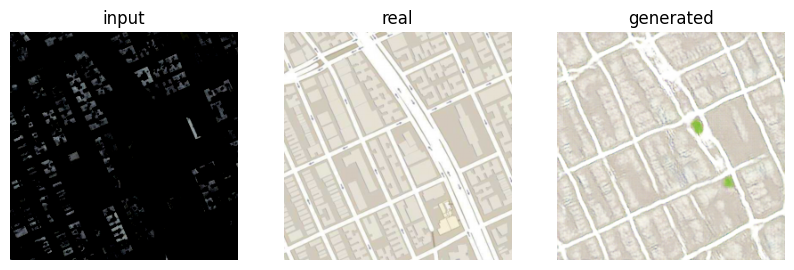

Epoch: 30


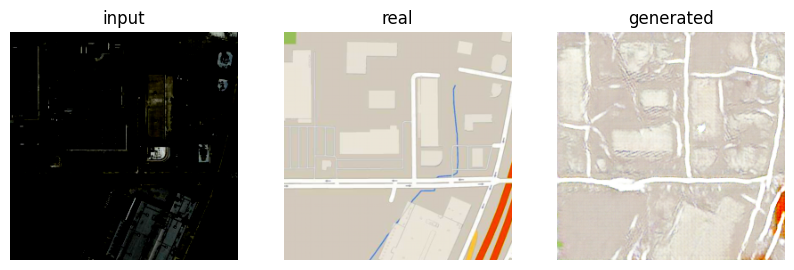

Epoch: 31


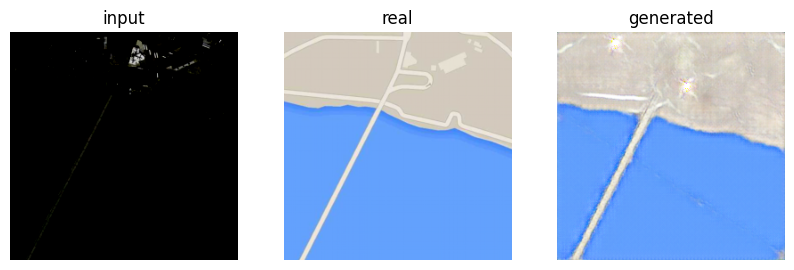

Epoch: 32


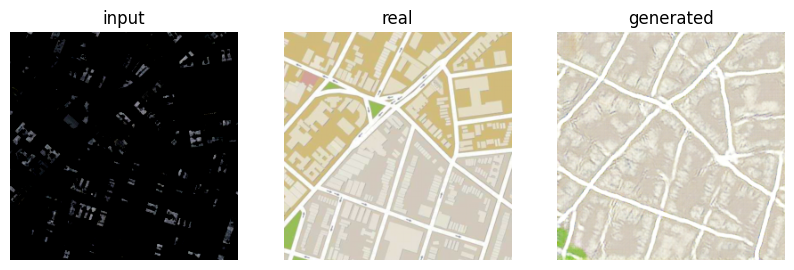

Epoch: 33


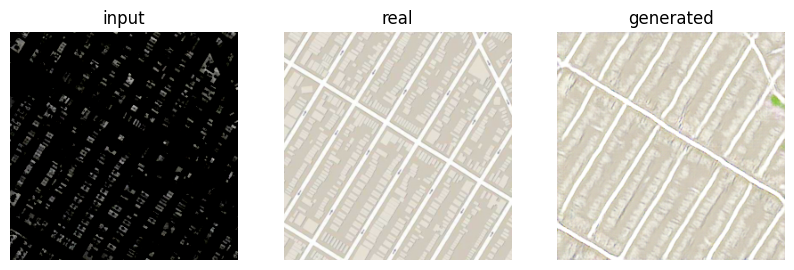

Epoch: 34


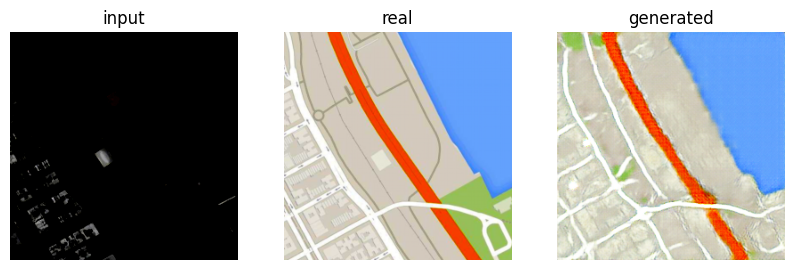

Epoch: 35


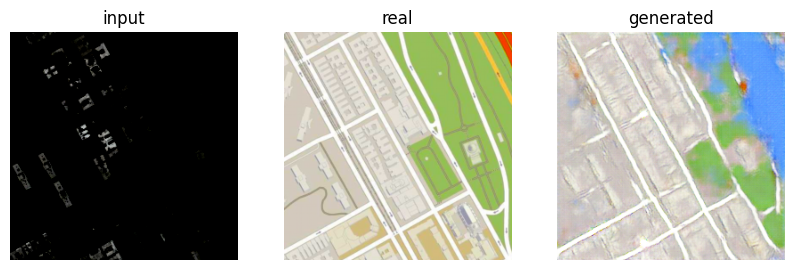

Epoch: 36


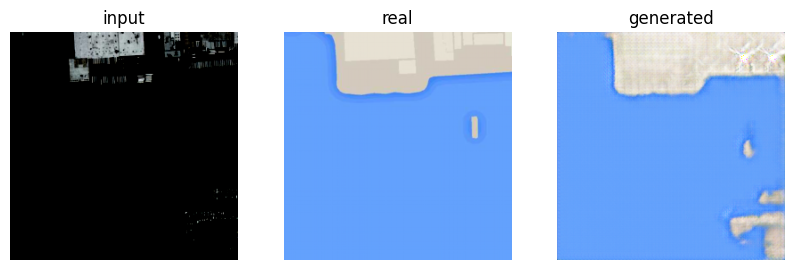

Epoch: 37


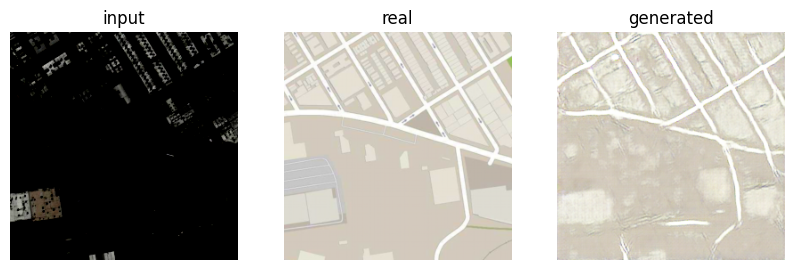

Epoch: 38


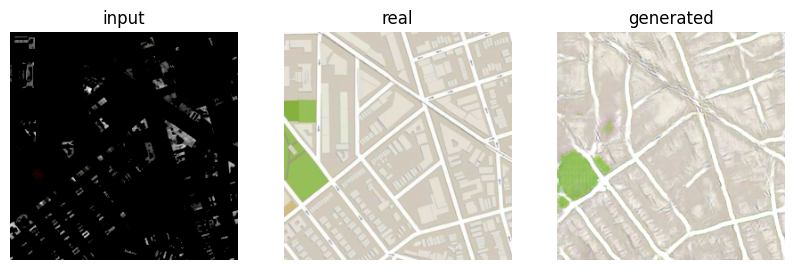

Epoch: 39


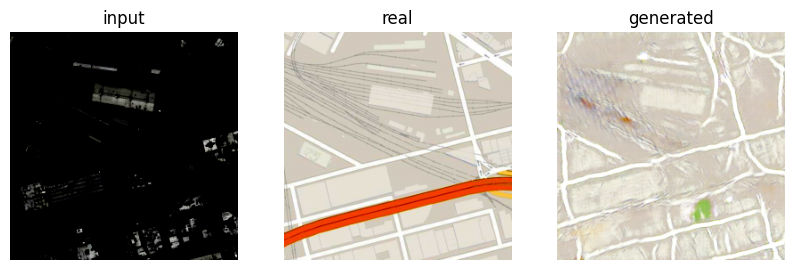

Epoch: 40


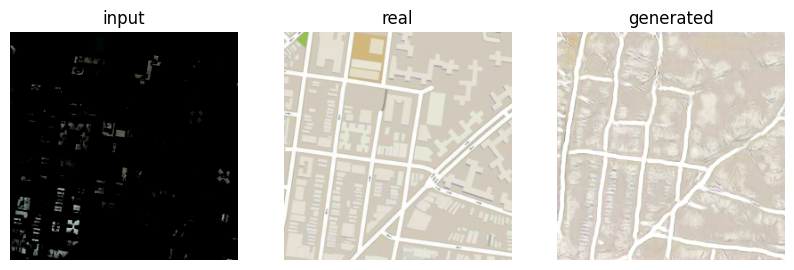

Epoch: 41


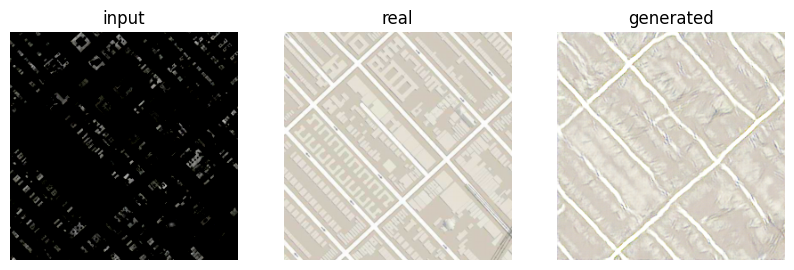

Epoch: 42


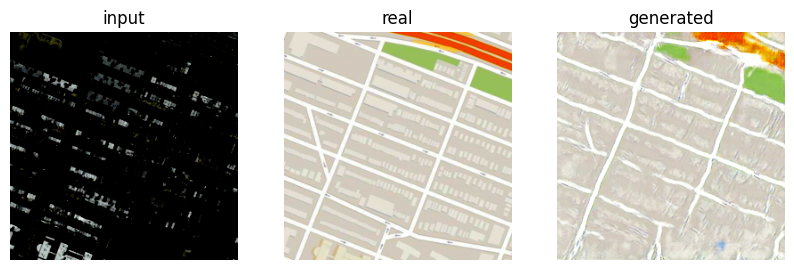

Epoch: 43


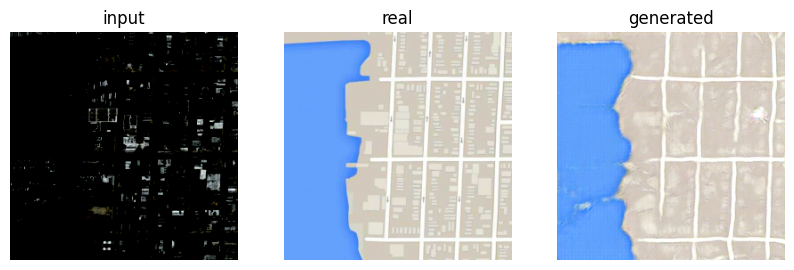

Epoch: 44


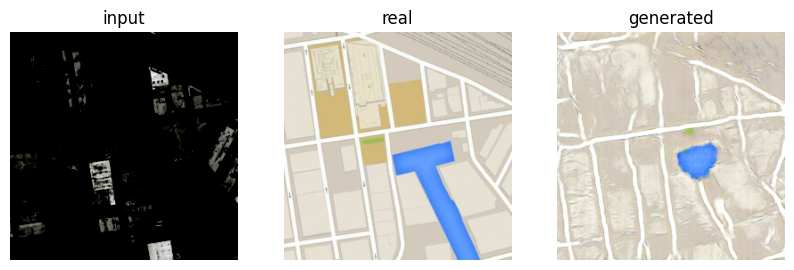

Epoch: 45


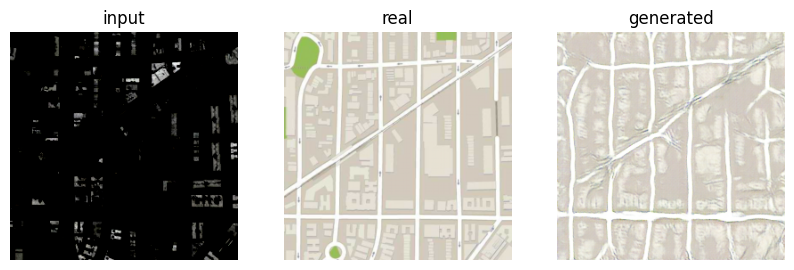

Epoch: 46


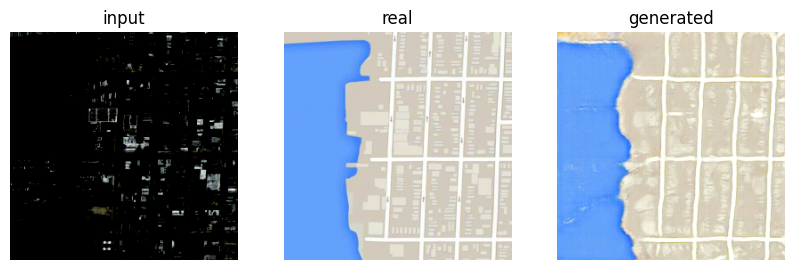

Epoch: 47


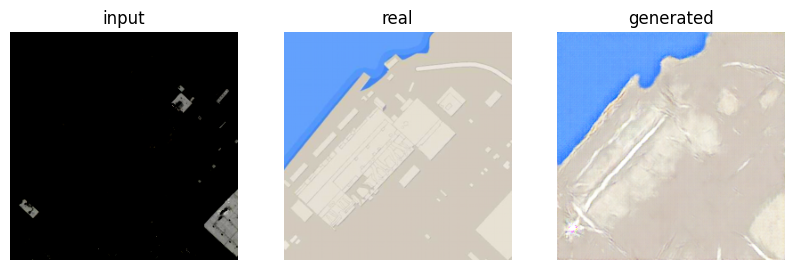

Epoch: 48


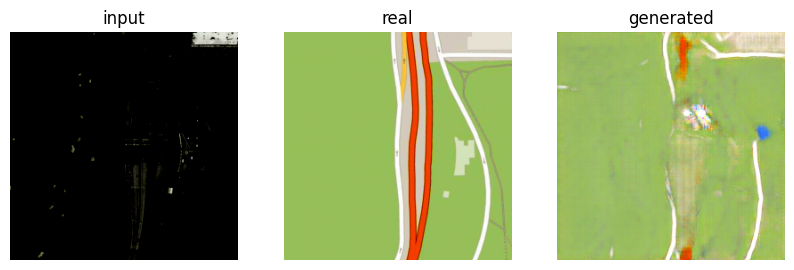

Epoch: 49


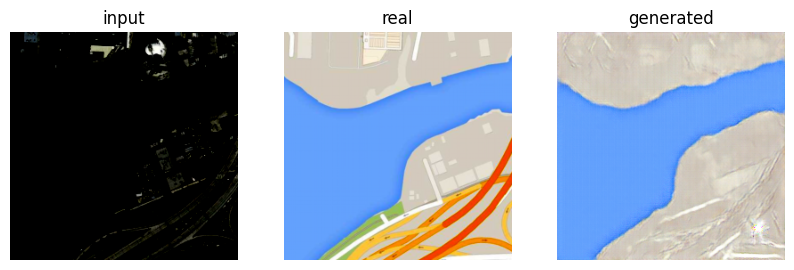

Epoch: 50


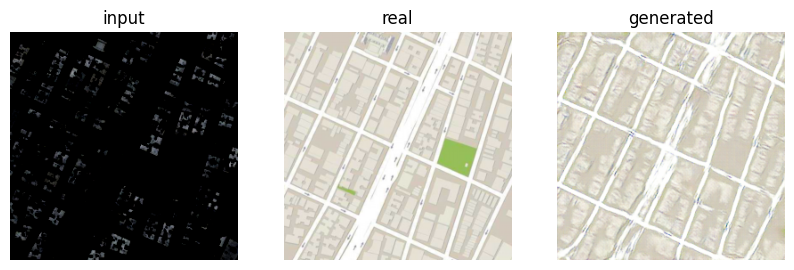

Epoch: 51


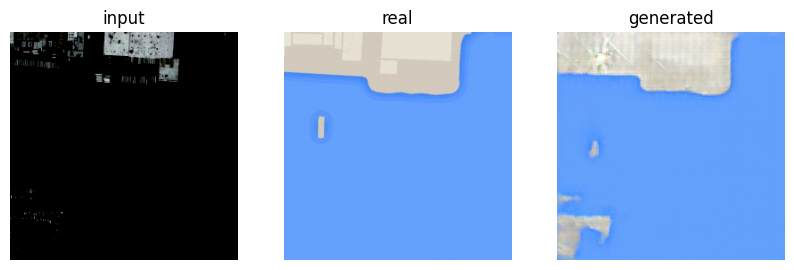

Epoch: 52


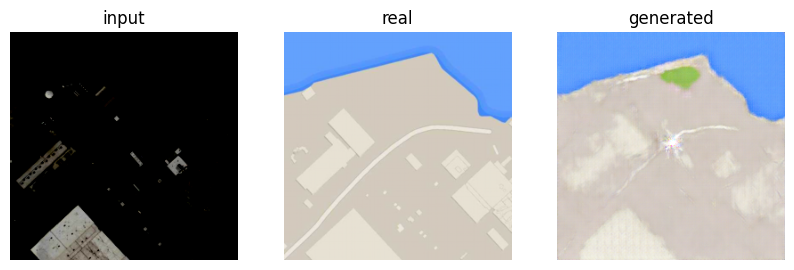

Epoch: 53


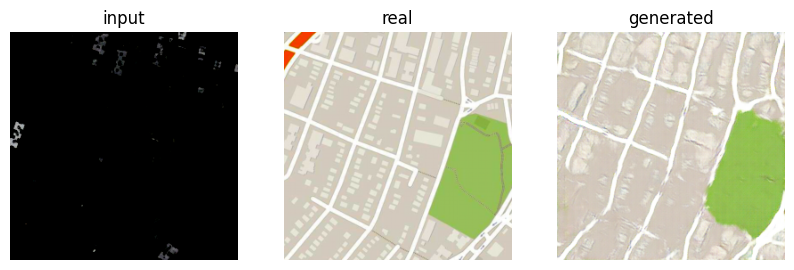

Epoch: 54


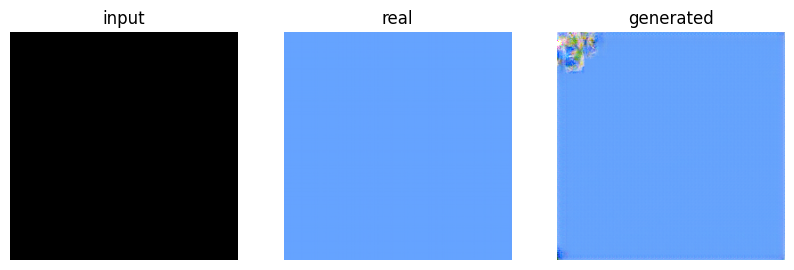

Epoch: 55


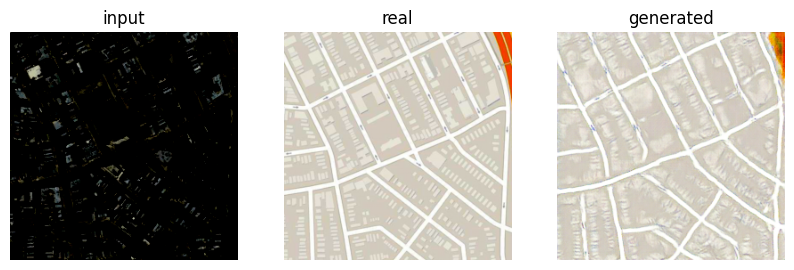

Epoch: 56


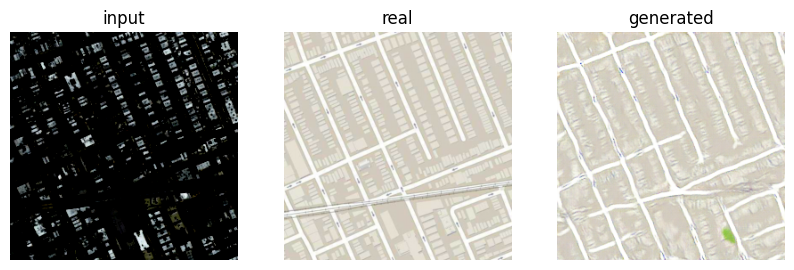

Epoch: 57


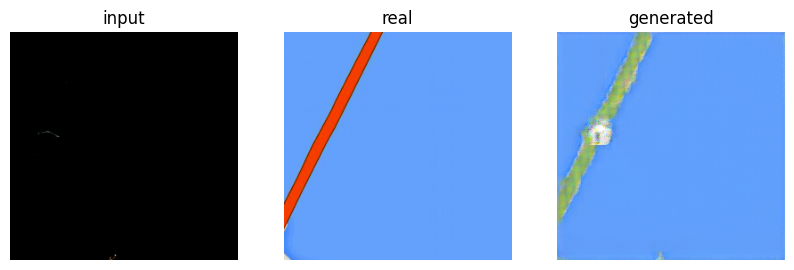

Epoch: 58


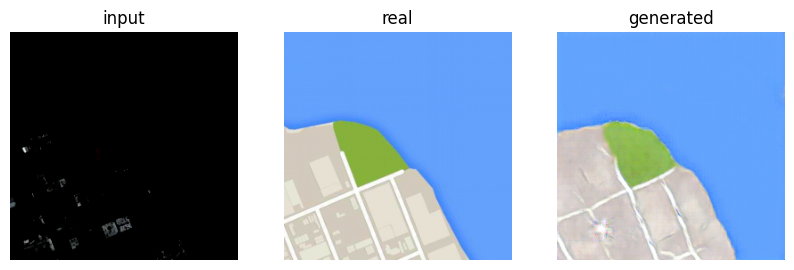

Epoch: 59


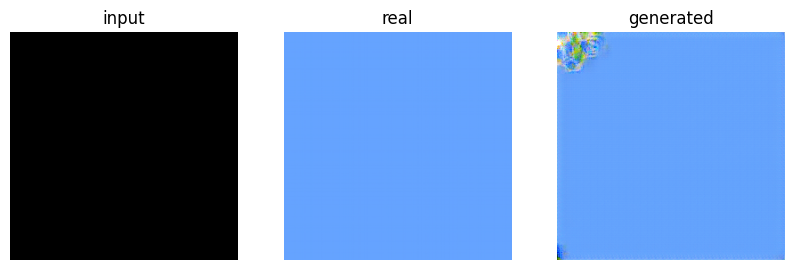

Epoch: 60


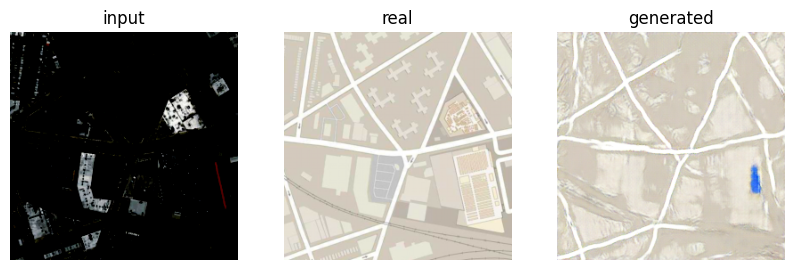

Epoch: 61


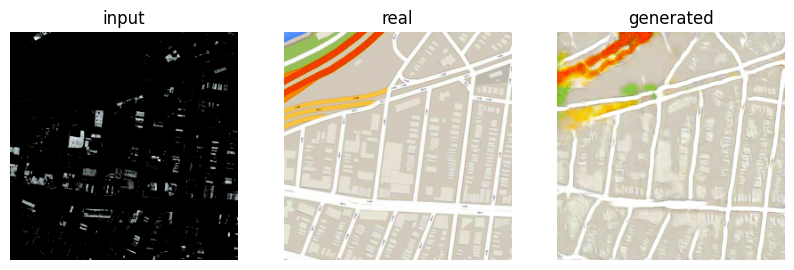

Epoch: 62


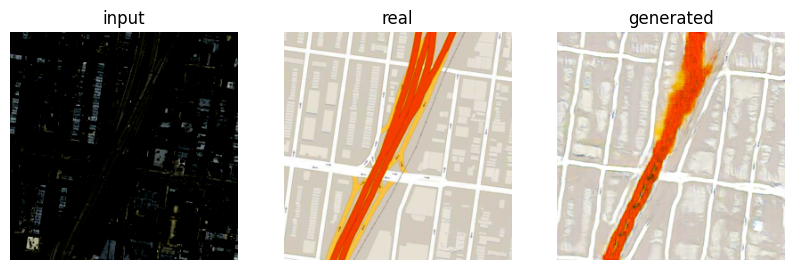

Epoch: 63


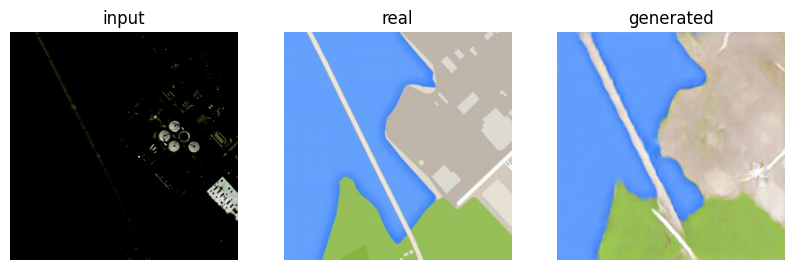

Epoch: 64


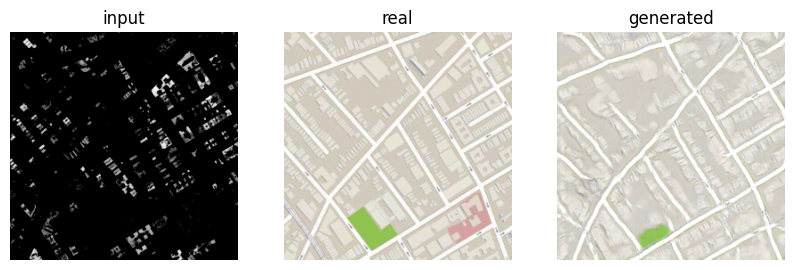

Epoch: 65


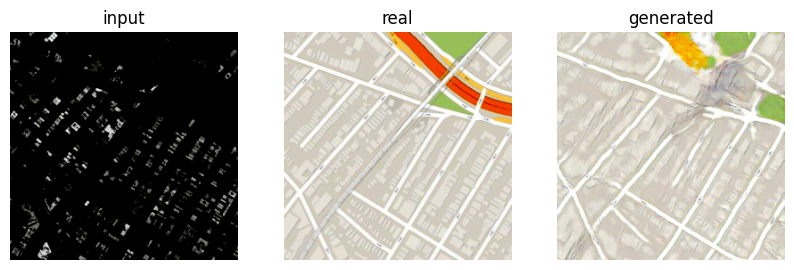

Epoch: 66


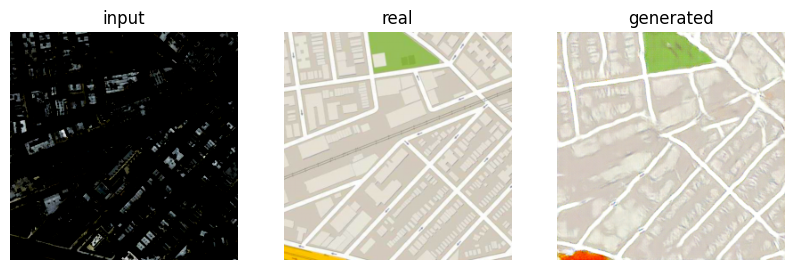

Epoch: 67


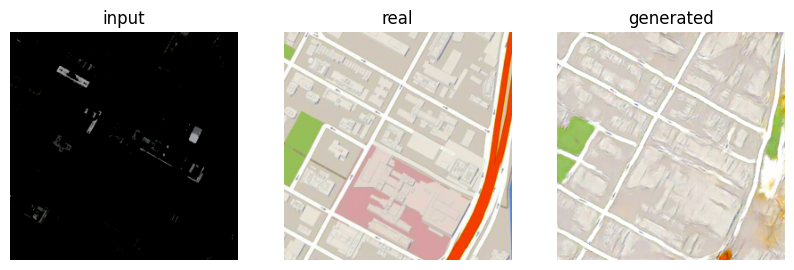

Epoch: 68


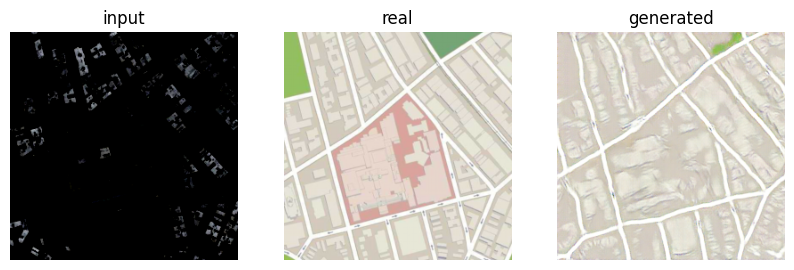

Epoch: 69


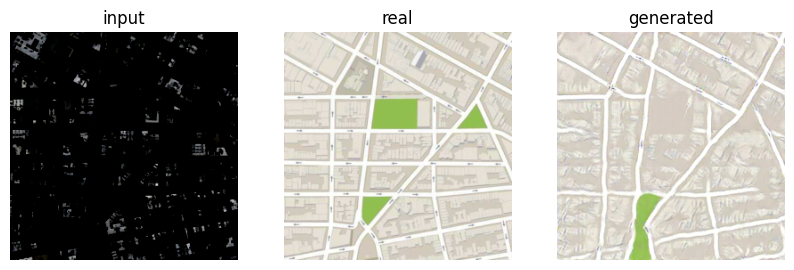

Epoch: 70


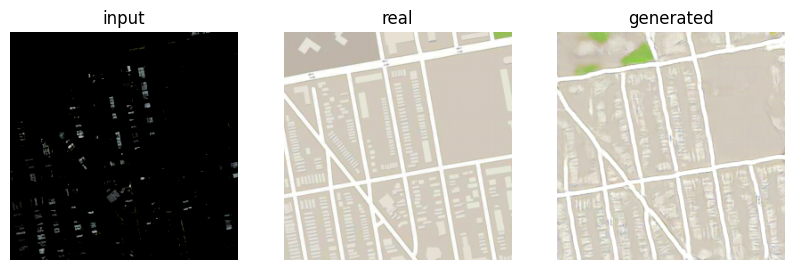

Epoch: 71


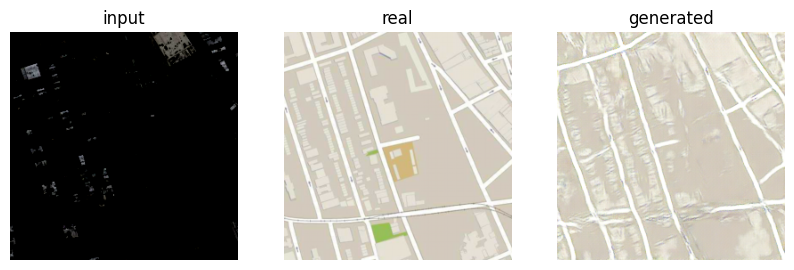

Epoch: 72


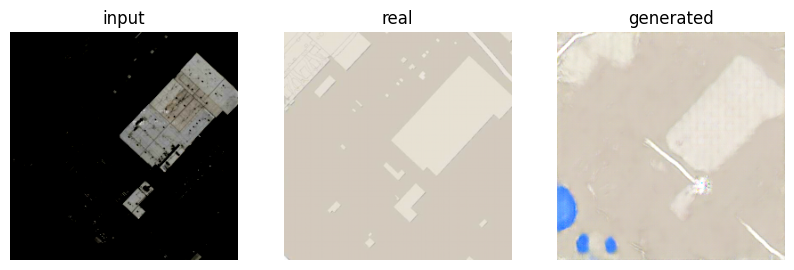

Epoch: 73


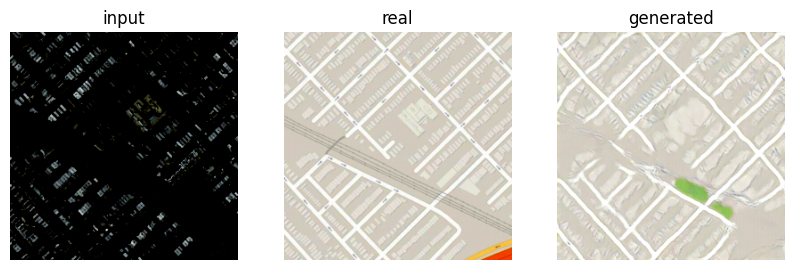

Epoch: 74


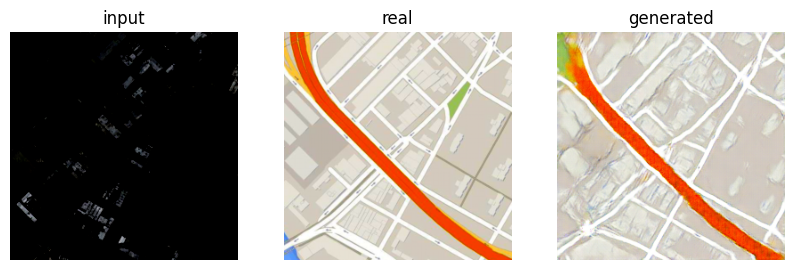

Epoch: 75


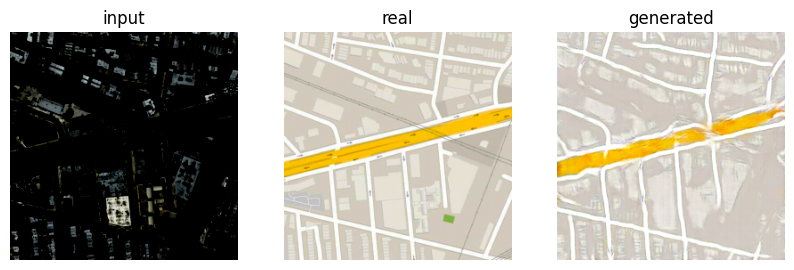

Epoch: 76


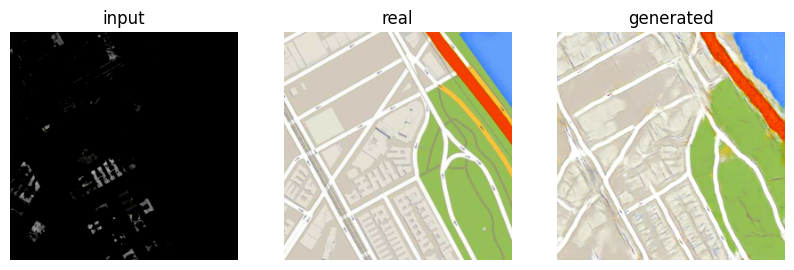

Epoch: 77


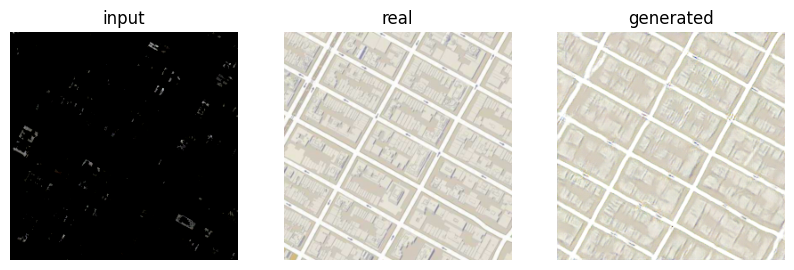

Epoch: 78


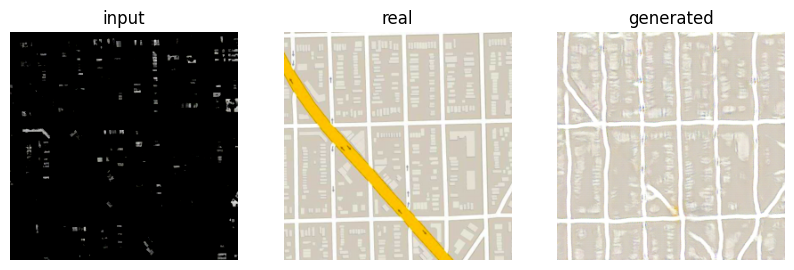

Epoch: 79


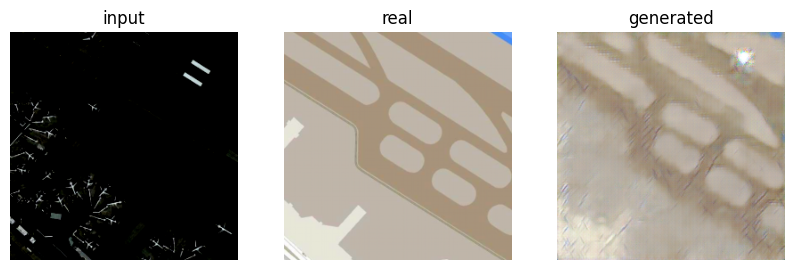

Epoch: 80


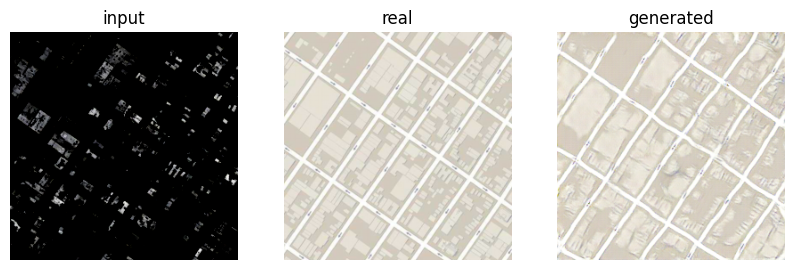

Epoch: 81


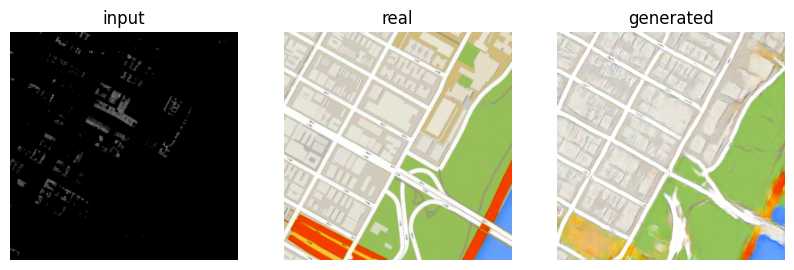

Epoch: 82


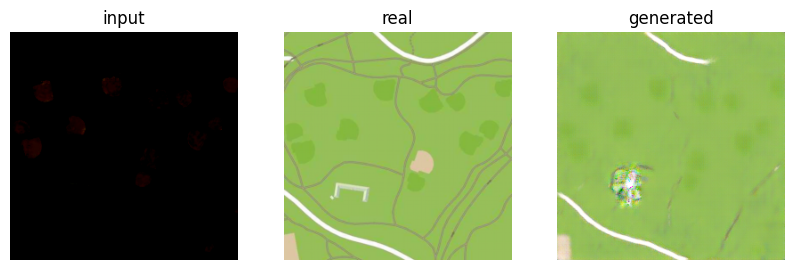

Epoch: 83


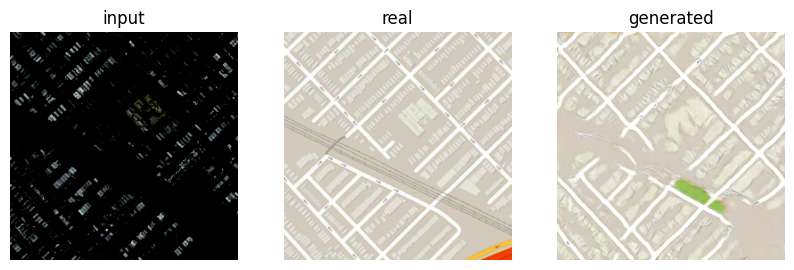

Epoch: 84


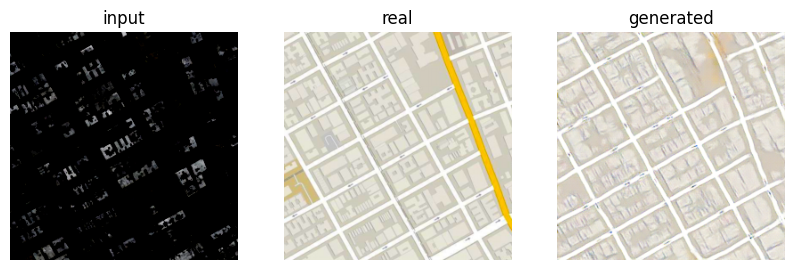

Epoch: 85


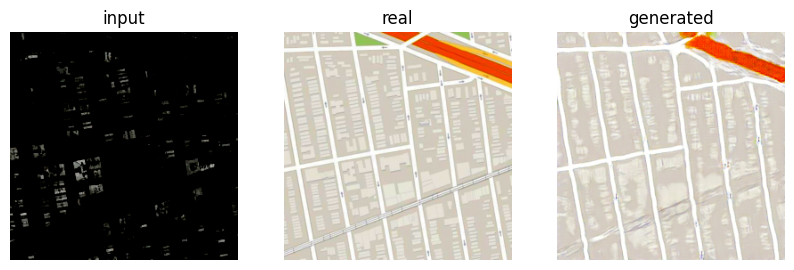

Epoch: 86


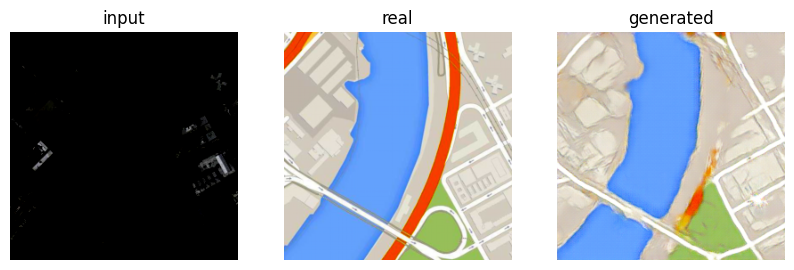

Epoch: 87


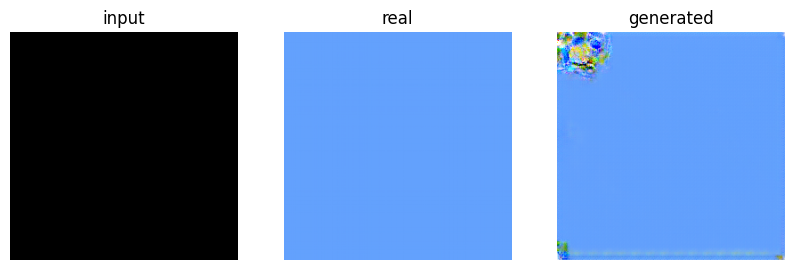

Epoch: 88


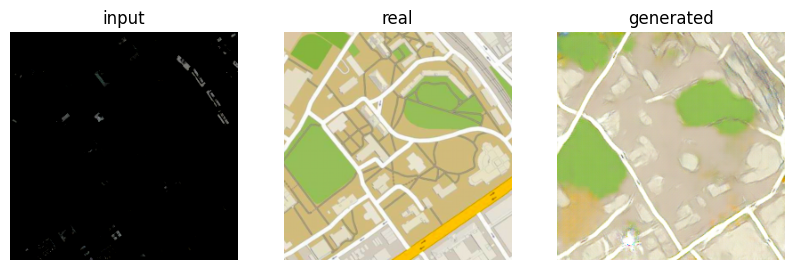

Epoch: 89


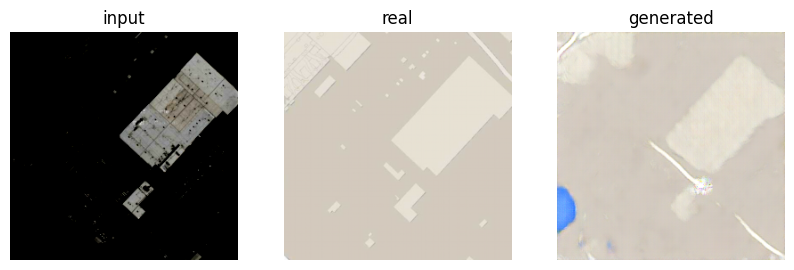

Epoch: 90


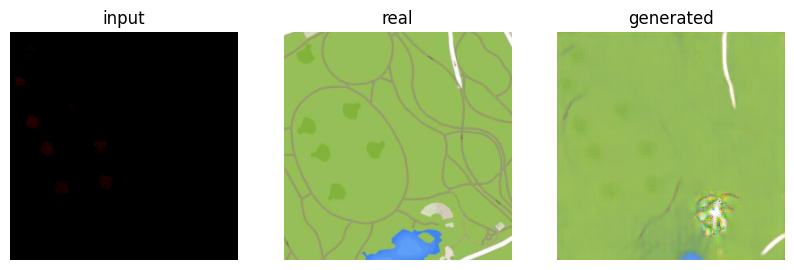

Epoch: 91


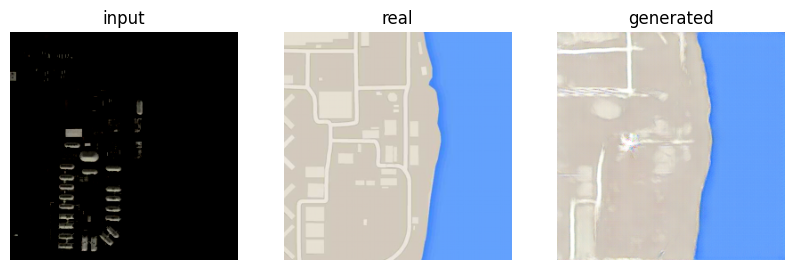

Epoch: 92


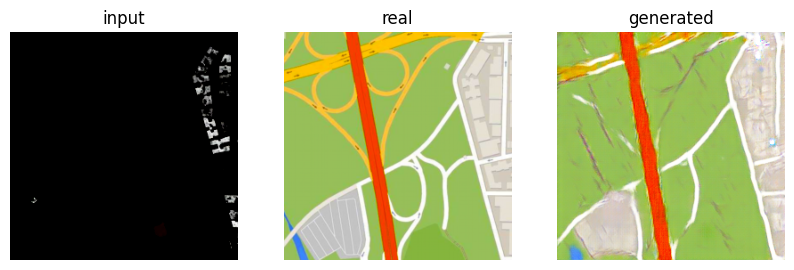

Epoch: 93


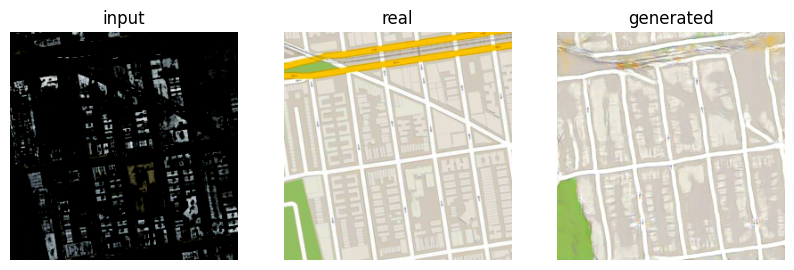

Epoch: 94


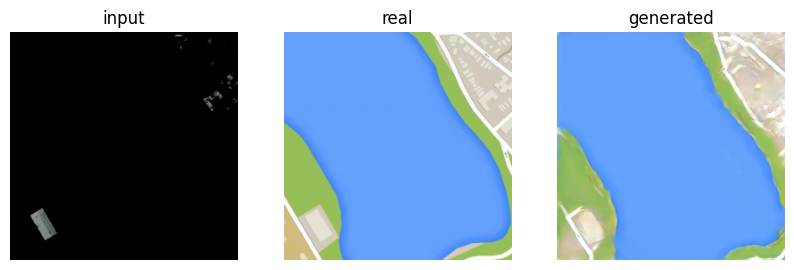

Epoch: 95


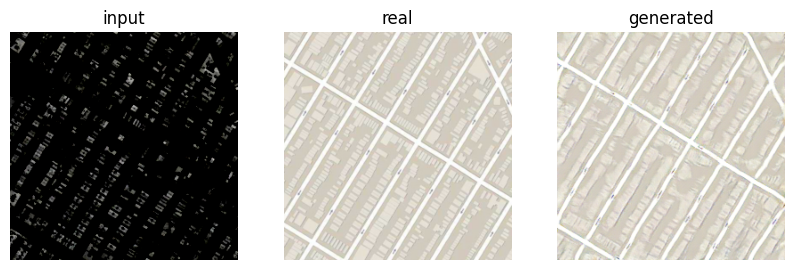

Epoch: 96


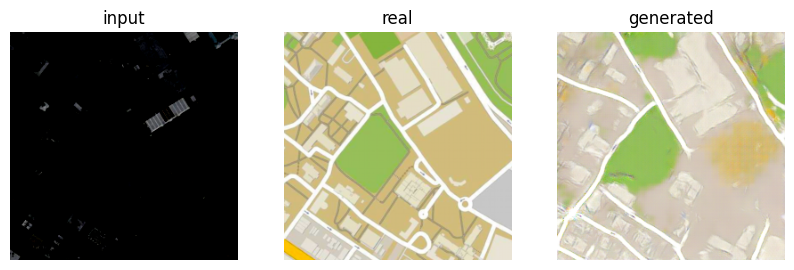

Epoch: 97


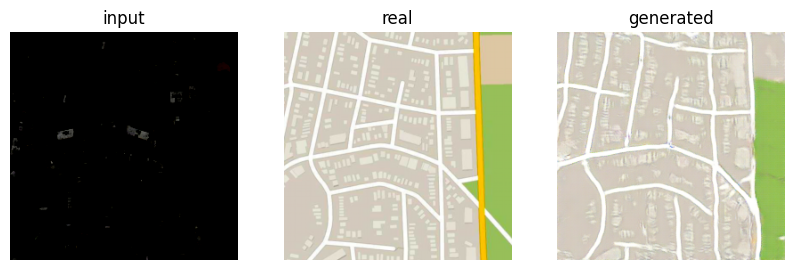

Epoch: 98


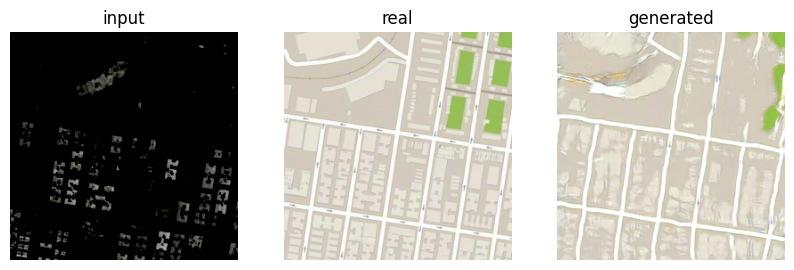

Epoch: 99


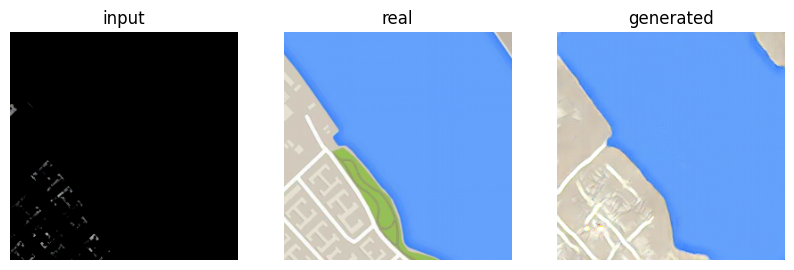

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_epochs=100` reached.


In [34]:
import pytorch_lightning as pl
from pytorch_lightning.callbacks import ModelCheckpoint
from torch.utils.data import DataLoader
import torch

transform = MapsTransform(0.5)
dataset = MapsDataset("maps/train", transform)
train_dataloader = DataLoader(
    dataset,
    batch_size=1,
    shuffle=True,
    num_workers=2
)
model = Pix2Pix()

# Define ModelCheckpoint callback
checkpoint_callback = ModelCheckpoint(
    dirpath="./checkpoints",  # Directory to save the checkpoints
    filename="pix2pix-{epoch:02d}-{Generator loss:.2f}",  # Checkpoint filename format
    save_top_k=5,  # Save top 3 models
    monitor="Generator loss",  # Monitor the generator loss
    mode="min",  # Save the model with minimum generator loss
)

trainer = pl.Trainer(
    accelerator="auto",
    precision=16,
    devices=1 if torch.cuda.is_available() else None,  # limiting for iPython runs
    max_epochs=100,
    callbacks=[pl.callbacks.TQDMProgressBar(refresh_rate=20), checkpoint_callback],
    default_root_dir="./",
)

trainer.fit(
    model=model,
    train_dataloaders=train_dataloader
)

In [35]:
torch.save(model.state_dict(), 'pix2pix_model.pth')

INFO:pytorch_lightning.utilities.rank_zero:Using 16bit Automatic Mixed Precision (AMP)
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name          | Type              | Params | Mode 
------------------------------------------------------------
0 | discriminator | Discriminator     | 2.8 M  | train
1 | generator     | Generator         | 54.4 M | train
2 | bce           | BCEWithLogitsLoss | 0      | train
3 | l1            | L1Loss            | 0      | train
------------------------------------------------------------
57.2 M    Trainable params
0         Non-trainable params
57.2 M    Total params
228.756   Total estimated model params size (MB)


Training: |          | 0/? [00:00<?, ?it/s]

Epoch: 0


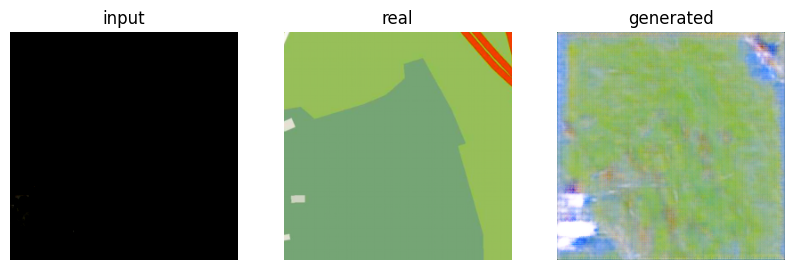

Epoch: 1


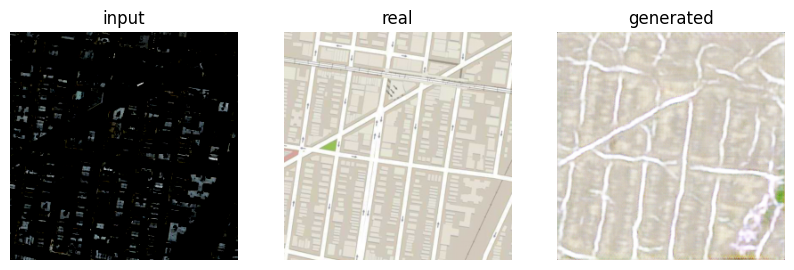

Epoch: 2


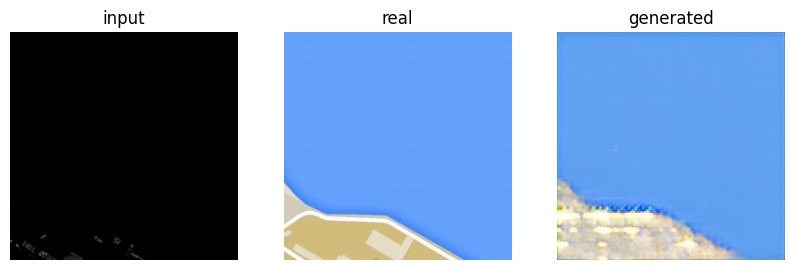

Epoch: 3


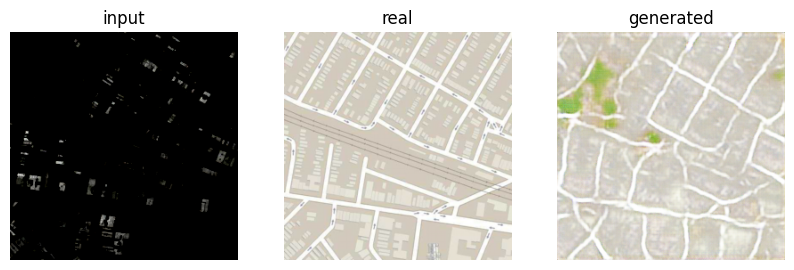

Epoch: 4


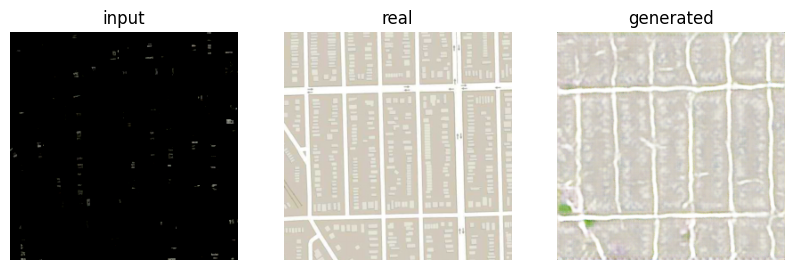

Epoch: 5


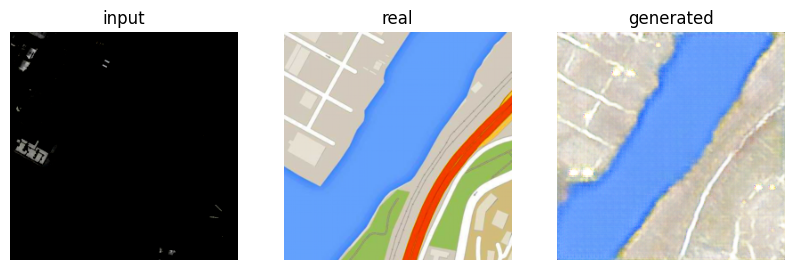

Epoch: 6


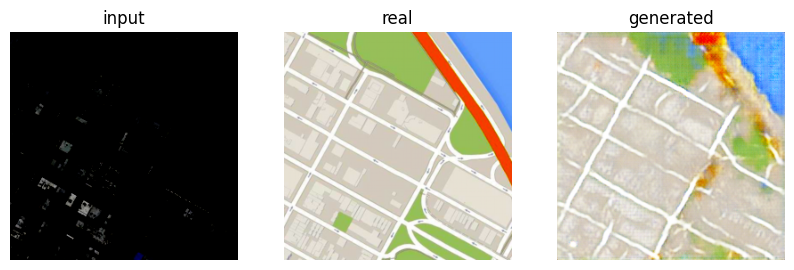

In [31]:
trainer = pl.Trainer(
    accelerator="auto",
    precision=16,
    devices=1 if torch.cuda.is_available() else None,  # limiting for iPython runs
    max_epochs=45,
    callbacks=[pl.callbacks.TQDMProgressBar(refresh_rate=20), checkpoint_callback],
    default_root_dir="./",
)

trainer.fit(
    model=model,
    train_dataloaders=train_dataloader
)